This notebook reproduces the experimental results presented in our manuscript. Instructions for accessing the data are available in /data/README.md.

In [4]:
import pandas as pd
import numpy as np

import matplotlib as mpl
import matplotlib.pyplot as plt

import scanpy as sc
import seaborn as sns

import sys 
sys.path.append("..") 
sys.path.append("../..") 

In [7]:
import os
os.chdir("/public/home/cit_wlhuang/SMART/SMART1/results/10x_human_lymph_node_A1")

In [8]:
path="../../datasets/10x_human_lymph_node_A1/"
result_path=path.replace("datasets","results")

In [9]:
adata=sc.read_h5ad(path+"adata_RNA.h5ad")
adata_adt=sc.read_h5ad(path+"adata_ADT.h5ad")

adata.var_names_make_unique()
adata_adt.var_names_make_unique()
adata.obs["anno"] = pd.read_csv(path+"annotation.csv", index_col=0)["manual-anno"]

benchmarking=['MOFA+', 'MEFISTO', 'MultiVI', 'PRESENT', 'scMM', 'SpatialGlue', 'TotalVI','SpaMultiVAE','CellCharter','MISO','COSMOS','SMART']
paths=['adata_mofa.h5ad', 'adata_mefisto.h5ad', 'adata_MultiVI.h5ad', 'adata_present.h5ad', 'adata_scMM.h5ad', 'adata_spatialglue.h5ad', 'adata_totalVI.h5ad', 
       'adataSpaMultiVAE.h5ad','adata_cellcharter.h5ad','adata_miso.h5ad','adata_COSMOS.h5ad','adata_SMART.h5ad']

/public/home/cit_wlhuang/.conda/envs/smart/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/public/home/cit_wlhuang/.conda/envs/smart/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [10]:
cluster1,cluster2=5,11

In [11]:
from smart.utils import pca
import muon.prot as pt
# RNA
sc.pp.filter_genes(adata, min_cells=10)
sc.pp.highly_variable_genes(adata, flavor="seurat_v3", n_top_genes=3000)
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
sc.pp.scale(adata)
adata = adata[:, adata.var['highly_variable']]
adata.obsm['X_RNA'] = pca(adata, n_comps=30)

# Protein

pt.pp.clr(adata_adt)
sc.pp.scale(adata_adt)
adata.obsm['X_ADT'] = pca(adata_adt, n_comps=30)

adata.obsm['X_Seurat']=np.hstack([pca(adata, n_comps=30),pca(adata, n_comps=30)])

/public/home/cit_wlhuang/.conda/envs/smart/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/tmp/ipykernel_2226203/421173017.py:10: ImplicitModificationWarning: Setting element `.obsm['X_RNA']` of view, initializing view as actual.
  adata.obsm['X_RNA'] = pca(adata, n_comps=30)
/public/home/cit_wlhuang/.conda/envs/smart/lib/python3.9/site-packages/muon/_prot/preproc.py:219: UserWarning: adata.X is sparse but not in CSC format. Converting to CSC.
  warn("adata.X is sparse but not in CSC format. Converting to CSC.")


In [12]:
path1='./'
for i,j in zip(benchmarking,paths):
    a=sc.read_h5ad(path1+j)
    a.obs.index=[k.split('_')[0] for k in a.obs.index]
    a=a[adata.obs_names]
    print(a.obsm)
    adata.obsm[f"X_{i}"]=next(iter(a.obsm.values()))
    print(i,adata.obsm[f"X_{i}"].shape)

AxisArraysView with keys: X_mofa, X_pca, spatial
MOFA+ (3484, 30)
AxisArraysView with keys: X_mefisto, feat, spatial
MEFISTO (3484, 30)
AxisArraysView with keys: X_MultiVI, spatial
MultiVI (3484, 64)
AxisArraysView with keys: embeddings, spatial
PRESENT (3484, 64)


/public/home/cit_wlhuang/.conda/envs/smart/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


AxisArraysView with keys: X_scMM, spatial
scMM (3484, 64)
AxisArraysView with keys: X_SpatialGlue, adj_feature, feat, spatial
SpatialGlue (3484, 64)
AxisArraysView with keys: X_totalVI, spatial
TotalVI (3484, 64)


/public/home/cit_wlhuang/.conda/envs/smart/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


AxisArraysView with keys: X_SpaMultiVAE, spatial
SpaMultiVAE (3484, 20)


/public/home/cit_wlhuang/.conda/envs/smart/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


AxisArraysView with keys: X_cellcharter, X_scVI, spatial
CellCharter (3484, 100)


/public/home/cit_wlhuang/.conda/envs/smart/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


AxisArraysView with keys: X_miso, spatial
MISO (3484, 96)


/public/home/cit_wlhuang/.conda/envs/smart/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


AxisArraysView with keys: COSMOS, Omics1_PCA, Omics1_PCA_norm, Omics2_PCA, Omics2_PCA_norm, Weights, spatial
COSMOS (3484, 50)
AxisArraysView with keys: SMART, SMART_pca, feat, spatial
SMART (3484, 64)


In [13]:
adata_WNN=sc.read_h5ad("adata_WNN.h5ad")
adata_SNF=sc.read_h5ad("adata_SNF.h5ad")
adata_WNN,adata_SNF

(AnnData object with n_obs × n_vars = 3484 × 0
     obs: 'rna:batch', 'rna:mod_weight', 'adt:mod_weight', 'leiden'
     uns: 'leiden', 'neighbors', 'umap'
     obsm: 'X_pca', 'X_umap', 'adt', 'rna', 'spatial'
     obsp: 'connectivities', 'distances',
 AnnData object with n_obs × n_vars = 3484 × 0
     obs: 'rna:batch'
     uns: 'neighbors', 'umap'
     obsm: 'X_pca', 'X_umap', 'adt', 'rna', 'spatial'
     obsp: 'connectivities', 'distances')

In [14]:
for i in adata.obsm:
    print(i,adata.obsm[i].shape)

spatial (3484, 2)
X_RNA (3484, 30)
X_ADT (3484, 30)
X_Seurat (3484, 60)
X_MOFA+ (3484, 30)
X_MEFISTO (3484, 30)
X_MultiVI (3484, 64)
X_PRESENT (3484, 64)
X_scMM (3484, 64)
X_SpatialGlue (3484, 64)
X_TotalVI (3484, 64)
X_SpaMultiVAE (3484, 20)
X_CellCharter (3484, 100)
X_MISO (3484, 96)
X_COSMOS (3484, 50)
X_SMART (3484, 64)


In [ ]:
for r in np.arange(0.3,1.5,0.05):
    sc.tl.leiden(adata_WNN,resolution=r,key_added=f"WNN_{r}")
    ncluster=len(adata_WNN.obs[f"WNN_{r}"].unique())
    print(f"resolution={r},ncluster={ncluster}")
    if ncluster>=cluster2:
        break
    
for n in range(cluster1,cluster2):
    for i in adata_WNN.obs:
        if "WNN_" in i and len(adata_WNN.obs[i].unique())==n:
            adata.obs[f"WNN_{n}"]=adata_WNN.obs[i]
            break

for r in np.arange(0.1,1.2,0.05):
    sc.tl.leiden(adata_SNF,resolution=r,key_added=f"SNF_{r}")
    ncluster=len(adata_SNF.obs[f"SNF_{r}"].unique())
    print(f"resolution={r},ncluster={ncluster}")
    if ncluster>=cluster2:
        break
        
for n in range(cluster1,cluster2):
    for i in adata_SNF.obs:
        if "SNF_" in i and len(adata_SNF.obs[i].unique())==n:
            adata.obs[f"SNF_{n}"]=adata_SNF.obs[i]
            break

In [ ]:
import os

os.environ['R_HOME'] = '/public/home/cit_wlhuang/.conda/envs/smart/lib/R'

from model.utils import clustering
for i in ['MOFA+', 'MEFISTO']:
    print(i)
    for n in range(cluster1,cluster2):
        clustering(adata, key="X_"+i, add_key=f"{i}_{n}", n_clusters=n, method="gmm", use_pca=True)
        
for i in ['RNA', 'ADT','PRESENT', 'MultiVI', 'scMM', 'SpatialGlue', 'TotalVI','SMART','SpaMultiVAE','CellCharter','MISO','COSMOS']:
    print(i)
    for n in range(cluster1,cluster2):
        clustering(adata, key="X_"+i, add_key=f"{i}_{n}", n_clusters=n, method="mclust", use_pca=True)


In [67]:
result_path=path.replace("datasets","results")
adata.write_h5ad(result_path+"adata_all.h5ad")

In [16]:
adata=sc.read_h5ad(result_path+"adata_all.h5ad")
adata

AnnData object with n_obs × n_vars = 3484 × 3000
    obs: 'anno', 'WNN_5', 'WNN_6', 'WNN_7', 'WNN_8', 'WNN_9', 'WNN_10', 'SNF_5', 'SNF_6', 'SNF_7', 'SNF_8', 'SNF_9', 'SNF_10', 'MOFA+_5', 'MOFA+_6', 'MOFA+_7', 'MOFA+_8', 'MOFA+_9', 'MOFA+_10', 'MEFISTO_5', 'MEFISTO_6', 'MEFISTO_7', 'MEFISTO_8', 'MEFISTO_9', 'MEFISTO_10', 'mclust', 'PRESENT_5', 'PRESENT_6', 'PRESENT_7', 'PRESENT_8', 'PRESENT_9', 'PRESENT_10', 'MultiVI_5', 'MultiVI_6', 'MultiVI_7', 'MultiVI_8', 'MultiVI_9', 'MultiVI_10', 'scMM_5', 'scMM_6', 'scMM_7', 'scMM_8', 'scMM_9', 'scMM_10', 'SpatialGlue_5', 'SpatialGlue_6', 'SpatialGlue_7', 'SpatialGlue_8', 'SpatialGlue_9', 'SpatialGlue_10', 'TotalVI_5', 'TotalVI_6', 'TotalVI_7', 'TotalVI_8', 'TotalVI_9', 'TotalVI_10', 'SMART_5', 'SMART_6', 'SMART_7', 'SMART_8', 'SMART_9', 'SMART_10', 'SpaMultiVAE_5', 'SpaMultiVAE_6', 'SpaMultiVAE_7', 'SpaMultiVAE_8', 'SpaMultiVAE_9', 'SpaMultiVAE_10', 'CellCharter_5', 'CellCharter_6', 'CellCharter_7', 'CellCharter_8', 'CellCharter_9', 'CellCharter

In [17]:
for i,j in zip(benchmarking,paths):
    if i=="SMART":
        a=sc.read_h5ad(result_path+j)
        a.obs.index=[k.split('_')[0] for k in a.obs.index]
        a=a[adata.obs_names]
        print(a.obsm)
        adata.obsm[f"X_{i}"]=next(iter(a.obsm.values()))
        print(i,adata.obsm[f"X_{i}"].shape)
        
import os

os.environ['R_HOME'] = '/public/home/cit_wlhuang/.conda/envs/smart/lib/R'       
from model.utils import clustering

for i in ['MISO']:
    print(i)
    for n in range(cluster1,cluster2):
        clustering(adata, key="X_"+i, add_key=f"{i}_{n}", n_clusters=n, method="gmm", use_pca=True)
# for i in ['SMART']:
#     print(i)
#     for n in range(cluster1,cluster2):
#         clustering(adata, key="X_"+i, add_key=f"{i}_{n}", n_clusters=n, method="mclust", use_pca=True)

AxisArraysView with keys: SMART, SMART_pca, feat, spatial
SMART (3484, 64)
MISO


In [ ]:
from sklearn.metrics.pairwise import pairwise_distances
from sklearn.neighbors import kneighbors_graph
from scipy.stats import pearsonr

dis1=pairwise_distances(adata.obsm["X_ADT"])
dis2=pairwise_distances(adata.obsm["X_RNA"])
df=pd.DataFrame(columns=["methods","modality","pearsonr"])
for j in ['MOFA+', 'MEFISTO','MultiVI', 'PRESENT', 'scMM', 'SpatialGlue', 'TotalVI','SMART','SpaMultiVAE','CellCharter','MISO','COSMOS']:
    dis=pairwise_distances(adata.obsm[f"X_{j}"])
    for i in range(dis.shape[0]):
        corr, _ = pearsonr(dis[i], dis1[i])
        df.loc[len(df)]=[j,"ADT",corr]
        corr, _ = pearsonr(dis[i], dis2[i])
        df.loc[len(df)]=[j,"RNA",corr]

/tmp/ipykernel_3783972/283927796.py:8: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels(),rotation=45, ha='right')


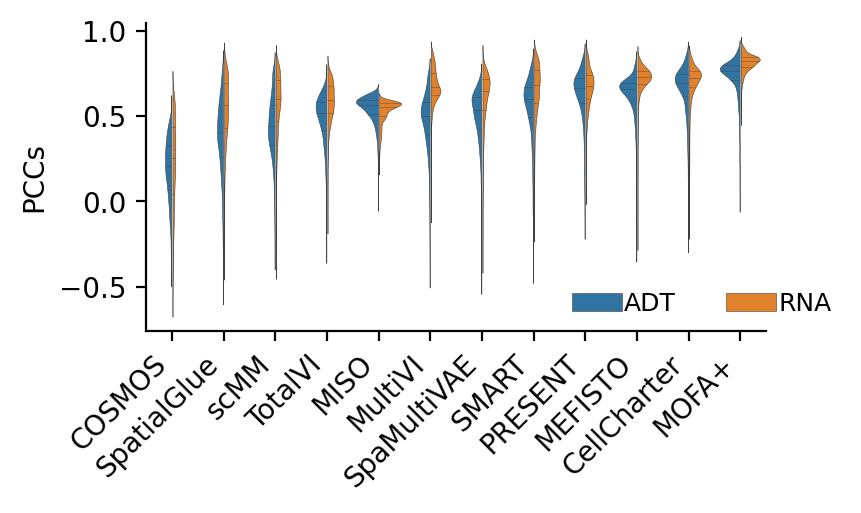

In [ ]:
df_s=df[df["modality"]=="ADT"].groupby("methods")["pearsonr"].median()+df[df["modality"]=="RNA"].groupby("methods")["pearsonr"].median()


fig,ax = plt.subplots(figsize=(4,2),dpi=200)
sns.violinplot(df,x="methods",y="pearsonr",hue="modality", split=True, gap=.05, inner="quart",linewidth=0.2,width=0.9,order=df_s.sort_values(ascending=True).index)
ax.set_ylabel("PCCs")
ax.set_xlabel("")
ax.set_xticklabels(ax.get_xticklabels(),rotation=45, ha='right')
ax.legend(bbox_to_anchor=(0.65,0.2),frameon=False,ncol=3,labelspacing=0.2,handletextpad=0.1,fontsize=9)
sns.despine()
fig.savefig("PCCs1.svg",format="svg",bbox_inches='tight',transparent=True)

In [ ]:
df2=pd.DataFrame(columns=["cluster","modality","pearsonr"])
dis=pairwise_distances(adata.obsm[f"X_SMART"])
for i,j in enumerate(adata.obs["SMART_7"].values):
    corr, _ = pearsonr(dis[i], dis1[i])
    df2.loc[len(df2)]=[j,"ADT",corr]
    corr, _ = pearsonr(dis[i], dis2[i])
    df2.loc[len(df2)]=[j,"RNA",corr]
fig,ax = plt.subplots(figsize=(4,2),dpi=200)
sns.violinplot(df2,x="cluster",y="pearsonr",hue="modality", split=True, gap=.05, inner="quart",linewidth=0.2,width=0.9)
ax.set_ylabel("PCCs")
ax.set_xlabel("")
ax.legend(bbox_to_anchor=(0.65,0.2),frameon=False,ncol=3,labelspacing=0.2,handletextpad=0.1,fontsize=9)
sns.despine()
fig.savefig("PCCs2.svg",format="svg",bbox_inches='tight',transparent=True)

In [ ]:
color_dicts = {
    'MOFA+': '#1f77b4',     # blue
    'MEFISTO': '#ff7f0e',   # orange
    'MultiVI': '#2ca02c',   # green
    'PRESENT': '#d62728',   # red
    'scMM': '#9467bd',      # purple
    'SpatialGlue': '#8c564b',  # brown
    'TotalVI': '#e377c2',   # pink
    'SpaMultiVAE': '#7f7f7f',  # gray
    'CellCharter': '#bcbd22',  # yellow-green
    'MISO': '#17becf',      # cyan
    'COSMOS': '#FFC0CB',    # light pink
    'SMART': '#ff69b4',     # hot pink
    'SNF': '#ff6347',       # tomato red
    'WNN': '#4682b4',       # steel blue
}


/tmp/ipykernel_1697266/53349130.py:9: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  df1.loc[len(df1)]=[j,i,r["I"][0]]
/tmp/ipykernel_1697266/53349130.py:9: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  df1.loc[len(df1)]=[j,i,r["I"][0]]
/tmp/ipykernel_1697266/53349130.py:9: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  df1.loc[len(df1)]=[j,i,r["I"][0]]
/tmp/ipykernel_1697266/53349130.py:9: FutureWarning: Series.__getitem__ treating k

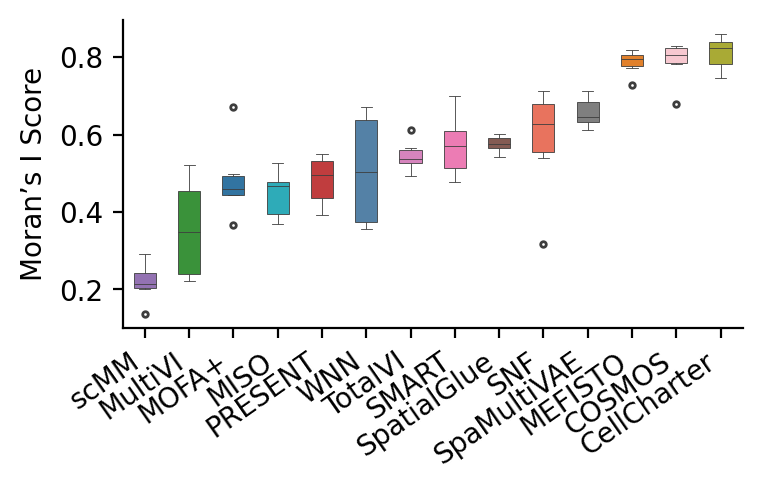

In [ ]:
import squidpy as sq

df1=pd.DataFrame(columns=["method","cluster","morans_i"])
sc.pp.neighbors(adata, use_rep="spatial",n_neighbors=10)
for j in ['WNN',"SNF",'MOFA+', 'MEFISTO','MultiVI', 'PRESENT', 'scMM', 'SpatialGlue', 'TotalVI','SMART','SpaMultiVAE','CellCharter','MISO','COSMOS']:
    for i in range(cluster1,cluster2):
        r=sq.gr.spatial_autocorr(adata, connectivity_key='connectivities', genes=[f"{j}_{i}"], mode='moran',attr="obs",copy=True) 
        #alt = sc.metrics.morans_i(adata, obsm=f"X_{j}")
        df1.loc[len(df1)]=[j,i,r["I"][0]]
df1["method"]=df1["method"].map(lambda x:"SMART" if x=='SMART' else x)

fig,ax = plt.subplots(figsize=(4,2),dpi=200)
sns.boxplot(df1,x="method",y="morans_i",linewidth=0.3,width=0.5,fliersize=2,palette=color_dicts,order=df1.groupby("method")["morans_i"].median().sort_values(ascending=True).index)
ax.set_ylabel("Moran’s I Score")
ax.set_xlabel("")
ax.set_xticklabels(ax.get_xticklabels(),rotation=35, ha='right')
sns.despine()
fig.savefig("Moran.svg",format="svg",bbox_inches='tight',transparent=True)

In [ ]:
from sklearn.metrics import adjusted_rand_score, normalized_mutual_info_score, adjusted_mutual_info_score, \
    homogeneity_score, mutual_info_score, v_measure_score,fowlkes_mallows_score,silhouette_score,\
    davies_bouldin_score,calinski_harabasz_score

result = pd.DataFrame(columns=["n_cluster","method","metries","score"])


for i in ['MOFA+', 'MEFISTO', 'WNN','SNF','MultiVI', 'PRESENT', 'scMM', 'SpatialGlue', 'TotalVI','SMART','SpaMultiVAE','CellCharter','MISO','COSMOS']:
    for j in range(cluster1,cluster2):
        try:
            n=f"{i}_{j}"
            ari = adjusted_rand_score(adata.obs['anno'], adata.obs[n])
            nmi = normalized_mutual_info_score(adata.obs['anno'], adata.obs[n])
            ami = adjusted_mutual_info_score(adata.obs['anno'], adata.obs[n])
            homogeneity = homogeneity_score(adata.obs['anno'], adata.obs[n])
            mutual_info = mutual_info_score(adata.obs['anno'], adata.obs[n])
            v_measure = v_measure_score(adata.obs['anno'], adata.obs[n])
            fmi=fowlkes_mallows_score(adata.obs['anno'], adata.obs[n])
        
            
        
            d={"ARI": ari,
                "NMI": nmi,
                "AMI": ami,
                "Homo": homogeneity,
                "MI": mutual_info,
                "V-Measure": v_measure,
                "FMI": fmi}
            
            for k,v in d.items():
                result.loc[len(result.index)]=[j,i,k,v]

            if f"X_{i}" in adata.obsm:
                d2={"SCI":silhouette_score(adata.obsm[f"X_{i}"],adata.obs[n]),
                    "DBI":davies_bouldin_score(adata.obsm[f"X_{i}"],adata.obs[n]),
                    "CH":calinski_harabasz_score(adata.obsm[f"X_{i}"],adata.obs[n])}
                for k,v in d2.items():
                    result.loc[len(result.index)]=[j,i,k,v]
           
            
        except:
            print(i)

result.to_csv(result_path+"result.csv")

In [19]:
result=pd.read_csv(result_path+"result.csv",index_col=0)

/tmp/ipykernel_2226203/3563139252.py:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(y="method",x="score",data=result_,ax=ax[k], fliersize=2,linewidth=0.8,width=0.6,palette=color_dicts,order=od, showfliers=False)
/tmp/ipykernel_2226203/3563139252.py:13: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax[k].legend().remove()
/tmp/ipykernel_2226203/3563139252.py:18: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax[k].set_xticklabels(ax[k].get_xticklabels(),fontsize=7)
/tmp/ipykernel_2226203/3563139252.py:19: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

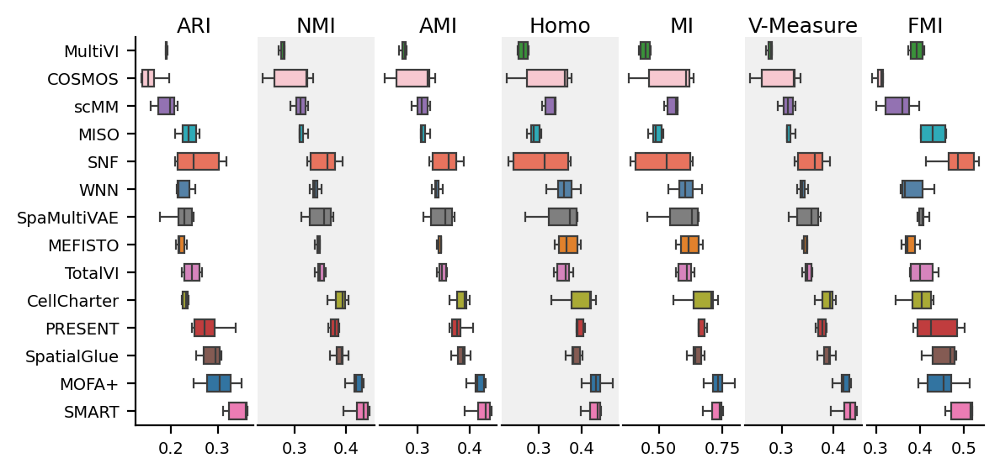

In [22]:
result=result[result["metries"].isin(["ARI","NMI","AMI","Homo","MI","V-Measure","FMI"])]
od=result.groupby("method")["score"].mean().sort_values(ascending=True).index
od=result.groupby("method")["score"].mean().sort_values(ascending=True).index
import seaborn as sns
fig,ax = plt.subplots(1,7,figsize=(6.5,3),dpi=200)
plt.subplots_adjust(wspace=0.04)

for k,i in enumerate(["ARI","NMI","AMI","Homo","MI","V-Measure","FMI"]):
    result_=result[result["metries"]==i]
    sns.boxplot(y="method",x="score",data=result_,ax=ax[k], fliersize=2,linewidth=0.8,width=0.6,palette=color_dicts,order=od, showfliers=False)
    ax[k].set_xlabel("")
    ax[k].set_ylabel("")
    ax[k].legend().remove()
    # s1,s2=ax[k].get_xlim()
    # print(s1,s2)
    # if k!=0:
    # ax[k].set_xlim(s2-(s2-s1)*2/3,s2)
    ax[k].set_xticklabels(ax[k].get_xticklabels(),fontsize=7)
    ax[k].set_yticklabels(ax[k].get_yticklabels(),fontsize=7,rotation=0)
    ax[k].spines["top"].set_visible(False)
    ax[k].spines["right"].set_visible(False)
    ax[k].set_title(i,fontsize=9,pad=0.5)
    # ax[k].text(
    #     0.5, 4, i,
    #     ha="center", va="top",
    #     fontsize=8, color="black",
    #     bbox=dict(facecolor="lightblue", edgecolor="white", boxstyle="square,pad=0.3"),
    #     transform=ax[k].transAxes
    # )
    if k%2==1:
        ax[k].set_facecolor("#f0f0f0")
    # else:
    #     ax[k].set_facecolor("lightblue")
    if k>0:
        ax[k].set_yticks([])
        ax[k].spines["left"].set_visible(False) 
plt.savefig("Boxplot-A1.svg",format="svg",bbox_inches='tight')
plt.show()    

/tmp/ipykernel_1697266/715764314.py:8: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels())


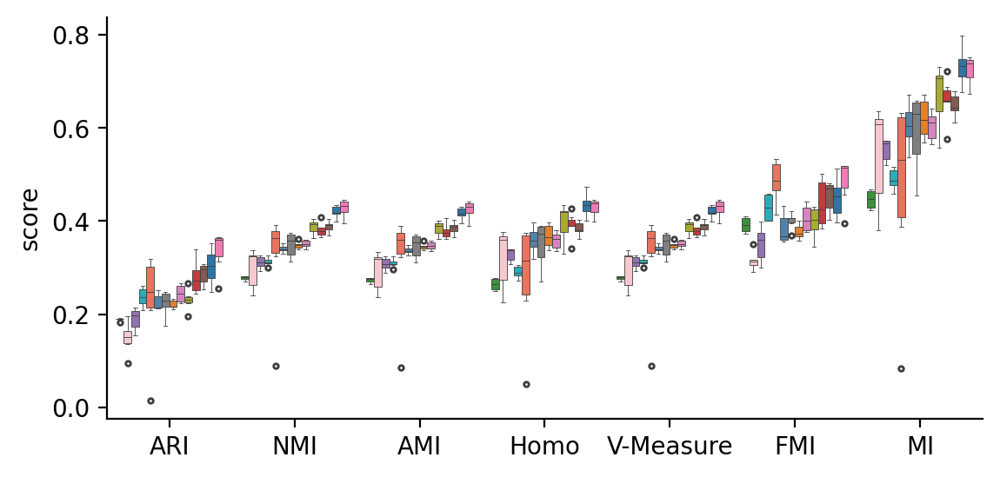

In [ ]:
result=result[result["metries"].isin(["ARI","NMI","AMI","Homo","MI","V-Measure","FMI"])]
od=result.groupby("method")["score"].mean().sort_values(ascending=True).index
import seaborn as sns
fig,ax = plt.subplots(figsize=(6.5,3),dpi=200)
sns.boxplot(x="metries",y="score",hue="method",data=result,ax=ax, fliersize=2,linewidth=0.3,width=0.85,palette=color_dicts,hue_order=od,order=["ARI","NMI","AMI","Homo","V-Measure","FMI","MI"])
ax.set_yticks([0,0.2,0.4,0.6,0.8])
ax.set_xlabel("")
ax.set_xticklabels(ax.get_xticklabels())
#ax.legend(loc=(0,0.7),frameon=False,ncol=4,labelspacing=0.1,handletextpad=0.1,fontsize=9)
ax.get_legend().remove()
sns.despine()
fig.savefig("metries1.svg",format="svg",bbox_inches='tight',transparent=True)

/tmp/ipykernel_1697266/2078149676.py:7: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(ax.get_xticklabels())


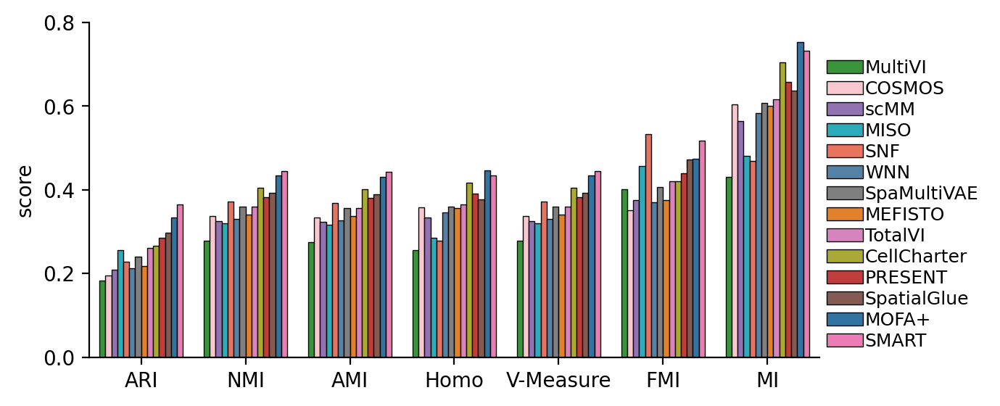

In [ ]:
fig,ax = plt.subplots(figsize=(6.5,3),dpi=200)
result_6=result[result["n_cluster"]==7]
sns.barplot(x="metries",y="score",hue="method",data=result_6,ax=ax,width=0.8,palette=color_dicts,hue_order=od, 
            edgecolor='black',linewidth=0.5,order=["ARI","NMI","AMI","Homo","V-Measure","FMI","MI"])
ax.set_yticks([0,0.2,0.4,0.6,0.8])
ax.set_xlabel("")
ax.set_xticklabels(ax.get_xticklabels())
ax.legend(loc=(1,0),frameon=False,ncol=1,labelspacing=0.2,handletextpad=0.1,fontsize=9)
sns.despine()
fig.savefig("metries2.svg",format="svg",bbox_inches='tight',transparent=True)

In [ ]:
colors = [
    '#1f77b4',  # blue
    '#ff7f0e',  # orange
    '#2ca02c',  # green
    '#d62728',  # red
    '#9467bd',  # purple
    '#8c564b',  # brown
    '#e377c2',  # pink
    '#7f7f7f',  # gray
    '#bcbd22',  # yellow
    '#17becf',  # cyan
    '#4a90e2',  # dark blue
    '#f5a623',  # dark orange
    '#7ed321',  # dark green
    '#d0021b',  # dark red
    '#8b6bbf',  # dark purple
    '#a7a8aa',  # dark gray
]
colordict=dict(zip(adata.obs["anno"].unique(),colors))
colordict

{'medulla sinuses': '#1f77b4',
 'medulla cords': '#ff7f0e',
 'cortex': '#2ca02c',
 'pericapsular adipose tissue': '#d62728',
 'follicle': '#9467bd',
 'capsule': '#8c564b',
 'hilum': '#e377c2',
 'medulla vessels': '#7f7f7f',
 'subcapsular sinus': '#bcbd22',
 'trabeculae': '#17becf'}

In [ ]:
import matplotlib.gridspec as gridspec
import matplotlib.pyplot as plt
plt.rcdefaults()
plt.rcParams["axes.titlesize"] = 10
plt.rcParams["legend.fontsize"] = 8               
plt.rcParams["legend.title_fontsize"] = 9 
plt.rcParams['axes.titlepad'] = 5

6
4
6
7
6
6


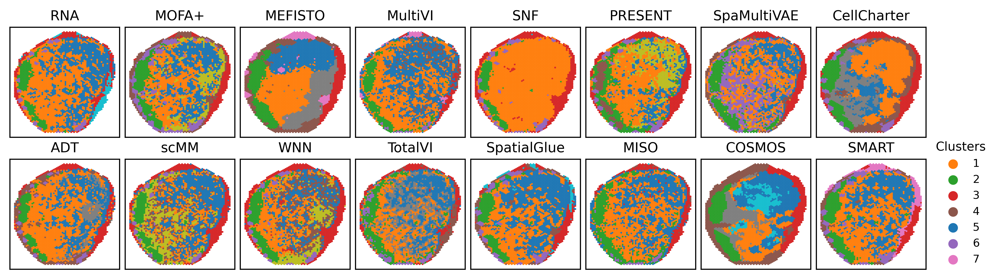

In [ ]:
from smart.utils import getcolordict
#gs = gridspec.GridSpec(2, 16)
fig, ax_list = plt.subplots(2, 8, figsize=(12, 3.2),dpi=600)
plt.subplots_adjust(hspace=0.2, wspace=0.05)
for i,j in enumerate(['RNA',  'MOFA+', 'MEFISTO', 'MultiVI','SNF','PRESENT','SpaMultiVAE','CellCharter']+['ADT',  'scMM', 'WNN', 'TotalVI','SpatialGlue','MISO','COSMOS','SMART']):
    adata.obs[j+"_7"]=adata.obs[j+"_7"].astype("str")
    colordict1=getcolordict(adata,j+"_7",'anno',colordict)
    #ax=plt.subplot(gs[i//8, 2*(i%8):2*(i%8)+2])
    ax=ax_list[i//8,i%8]
    sc.pl.embedding(adata, basis='spatial', color=j+"_7", ax=ax, s=7,palette=colordict1, show=False,title=j)
    ax.set_xlabel("")
    ax.set_ylabel("")
    #ax.axis("off")
    if i!=15:
        ax.get_legend().remove()
    else:
        ax.legend(title="Clusters",loc=(1.05,0),frameon=False)
plt.show()
#fig.savefig("cluster1.svg",format="svg",bbox_inches='tight',transparent=True)
fig.savefig("cluster1.jpg",format="jpg",bbox_inches='tight',transparent=True)
fig.savefig("cluster1.png",format="png",bbox_inches='tight',transparent=True)

In [ ]:
adata_SNF

AnnData object with n_obs × n_vars = 3484 × 0
    obs: 'rna:batch', 'SNF_7'
    uns: 'neighbors', 'umap'
    obsm: 'X_pca', 'adt', 'rna', 'spatial'
    obsp: 'connectivities', 'distances'

6
4
6
7
6
6


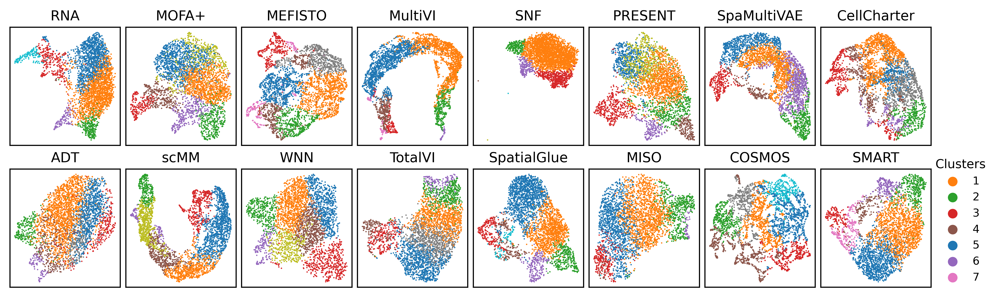

In [ ]:
#gs = gridspec.GridSpec(2, 12)
fig, ax_list = plt.subplots(2, 8, figsize=(12, 3.42),dpi=600)
plt.subplots_adjust(hspace=0.2, wspace=0.05)

adata_WNN=sc.read_h5ad(result_path+"adata_WNN.h5ad")
adata_SNF=sc.read_h5ad(result_path+"adata_SNF.h5ad")

for i,j in enumerate(['RNA',  'MOFA+', 'MEFISTO', 'MultiVI','SNF','PRESENT','SpaMultiVAE','CellCharter']+['ADT',  'scMM', 'WNN', 'TotalVI','SpatialGlue','MISO','COSMOS','SMART']):
    colordict1=getcolordict(adata,j+"_7",'anno',colordict)
    #ax=plt.subplot(gs[i//6, 2*(i%6):2*(i%6)+2])
    ax=ax_list[i//8,i%8]
    if j=="WNN":
        adata_WNN.obs[j+"_7"]=adata.obs[j+"_7"]
        sc.pl.umap(adata_WNN, color=j+"_7", ax=ax, title=j, s=4,palette=colordict1, show=False)
    elif j=="SNF":
        adata_SNF.obs[j+"_7"]=adata.obs[j+"_7"]
        sc.pl.umap(adata_SNF, color=j+"_7", ax=ax, title=j, s=4,palette=colordict1, show=False)
    else:
        sc.pp.neighbors(adata, use_rep="X_"+j, n_neighbors=10)
        sc.tl.umap(adata)
        sc.pl.umap(adata, color=j+"_7", ax=ax, title=j, s=4,palette=colordict1, show=False)
    ax.set_title(j)
    ax.set_xlabel("")
    ax.set_ylabel("")
    if i!=15:
        ax.get_legend().remove()
    else:
        ax.legend(title="Clusters",loc=(1,0),frameon=False)
plt.show()
fig.savefig("Umap1.jpg",format="jpg",bbox_inches='tight',transparent=True)
fig.savefig("Umap1.png",format="png",bbox_inches='tight',transparent=True)

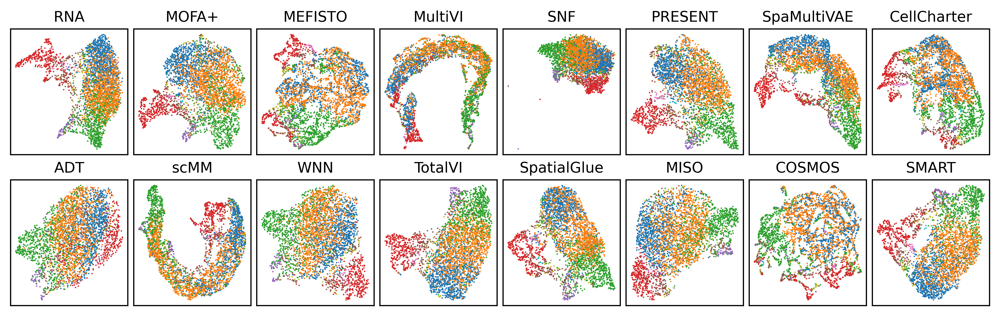

In [ ]:
#gs = gridspec.GridSpec(2, 12)
fig, ax_list = plt.subplots(2, 8, figsize=(12, 3.42),dpi=600)
plt.subplots_adjust(hspace=0.2, wspace=0.05)

adata_WNN=sc.read_h5ad(result_path+"adata_WNN.h5ad")
adata_SNF=sc.read_h5ad(result_path+"adata_SNF.h5ad")

for i,j in enumerate(['RNA',  'MOFA+', 'MEFISTO', 'MultiVI','SNF','PRESENT','SpaMultiVAE','CellCharter']+['ADT',  'scMM', 'WNN', 'TotalVI','SpatialGlue','MISO','COSMOS','SMART']):

    ax=ax_list[i//8,i%8]
    if j=="WNN":
        adata_WNN.obs['anno']=adata.obs['anno']
        sc.pl.umap(adata_WNN, color='anno', ax=ax, title=j, s=4,palette=colordict, show=False)
    elif j=="SNF":
        adata_SNF.obs['anno']=adata.obs['anno']
        sc.pl.umap(adata_SNF, color='anno', ax=ax, title=j, s=4,palette=colordict, show=False)
    else:
        sc.pp.neighbors(adata, use_rep="X_"+j, n_neighbors=10)
        sc.tl.umap(adata)
        sc.pl.umap(adata, color='anno', ax=ax, title=j, s=4,palette=colordict, show=False)
    ax.set_title(j)
    ax.set_xlabel("")
    ax.set_ylabel("")
    if i!=15:
        ax.get_legend().remove()
    else:
        ax.get_legend().remove()
        #ax.legend(title="Manual Annotation",loc=(1,0),frameon=False)
plt.show()
fig.savefig("Umap2.jpg",format="jpg",bbox_inches='tight',transparent=True)
fig.savefig("Umap2.png",format="png",bbox_inches='tight',transparent=True)

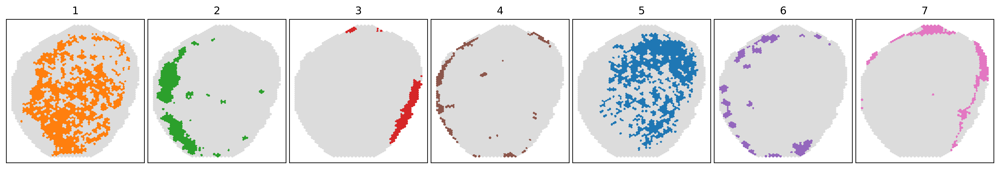

In [ ]:
from smart.utils import getcolordict
plt.rcParams["legend.title_fontsize"] = 10 
fig, ax_list = plt.subplots(1, 7, figsize=(16, 2.8),dpi=600)
colordict1=getcolordict(adata,"SMART_7",'anno',colordict)
for j in range(1,8):
    sc.pl.embedding(adata, basis='spatial', color='SMART_7', palette={str(i):colordict1[str(i)] if i==j else "#DCDCDC" for i in range(1,8)},ax=ax_list[j-1],title=str(j),show=False)
    ax_list[j-1].set_xlabel("")
    ax_list[j-1].set_ylabel("")
    ax_list[j-1].get_legend().remove()
plt.tight_layout(w_pad=0.4)
plt.show()
fig.savefig("cluster2.jpg",format="jpg",bbox_inches='tight',transparent=True)

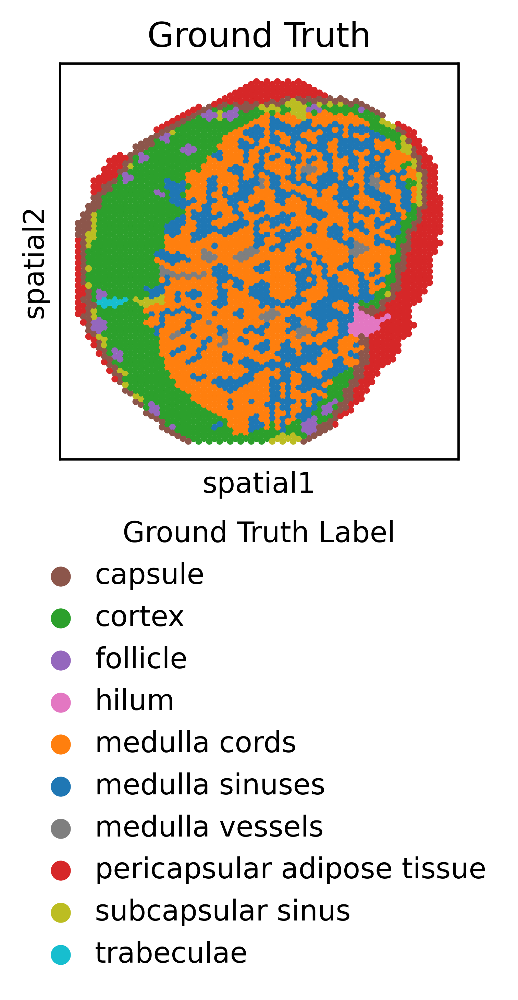

In [ ]:
plt.rcParams["legend.title_fontsize"] = 10 
fig, ax = plt.subplots(1, 1, figsize=(2.5, 2.5),dpi=600)
sc.pl.embedding(adata, basis='spatial', color='anno', ax=ax, title='manual-anno',palette=colordict, s=22,show=False)
ax.set_title("Ground Truth")
ax.legend(bbox_to_anchor=(0.5,-1.35),loc="lower center",frameon=False,ncol=1,labelspacing=0.5,handletextpad=0.2,title="Ground Truth Label")
plt.show()
fig.savefig("GT.jpg",format="jpg",bbox_inches='tight',transparent=True)
fig.savefig("GT.png",format="png",bbox_inches='tight',transparent=True)

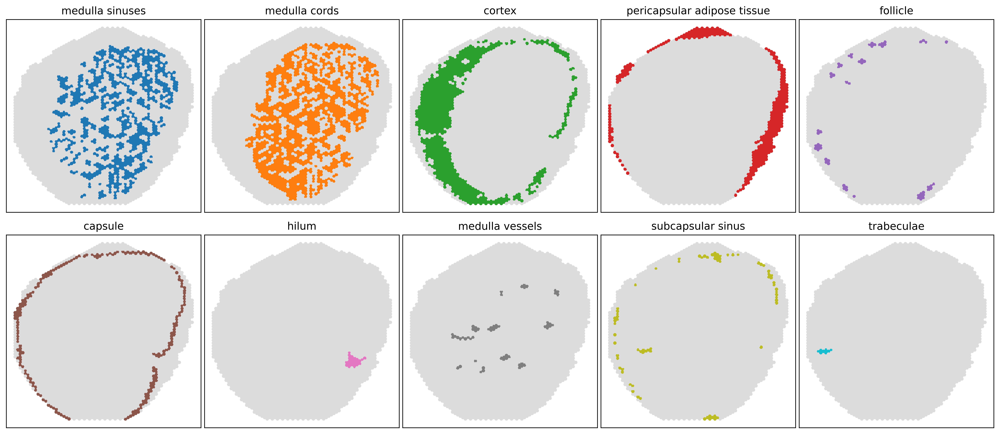

In [ ]:
fig, ax_list = plt.subplots(2, 5, figsize=(16, 7),dpi=600)
nk=list(colordict.keys())
for j in range(10):
    sc.pl.embedding(adata, basis='spatial', color='anno',s=60, palette={nk[i]:colordict[nk[i]] if i==j else "#DCDCDC" for i in range(10)},ax=ax_list[j//5][j%5],title=nk[j],show=False)
    ax_list[j//5][j%5].set_xlabel("")
    ax_list[j//5][j%5].set_ylabel("")
    ax_list[j//5][j%5].get_legend().remove()
plt.tight_layout(w_pad=0.4)
plt.show()
f.savefig()

In [ ]:
import muon.prot as pt

adata_adt=sc.read_h5ad(path+"adata_ADT.h5ad")
adata_adt.var_names_make_unique()
adata_adt.obs["SMART"]=adata.obs["SMART_7"]

nonzero_cells = np.array((adata_adt.X.sum(axis=1) > 0)).flatten()
adata_adt = adata_adt[nonzero_cells].copy()
pt.pp.clr(adata_adt)
# sc.pp.pca(adata_adt,n_comps=30)
# adata_adt.X=adata_adt.X.toarray()

#sc.pp.scale(adata_adt)

sc.tl.rank_genes_groups(adata_adt, 'SMART', method='wilcoxon')  # calculate differentially expressed genes
# sc.tl.dendrogram(adata_adt, 'SMART') 

/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/muon/_prot/preproc.py:219: UserWarning: adata.X is sparse but not in CSC format. Converting to CSC.
  warn("adata.X is sparse but not in CSC format. Converting to CSC.")


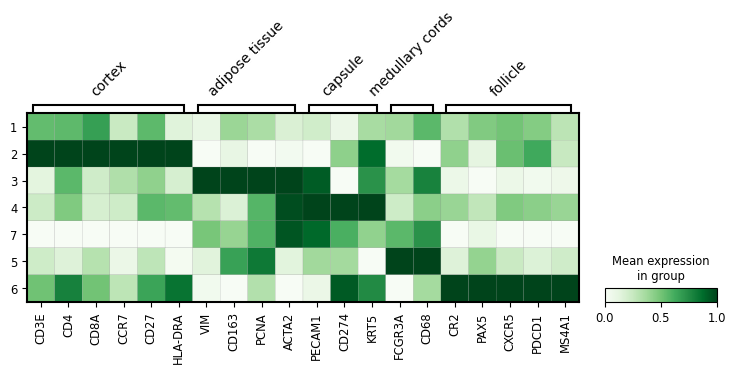

In [ ]:
rank_adt={  
    "cortex": ["CD3E", "CD4", "CD8A", "CCR7",  "CD27", "HLA-DRA"],
    "adipose tissue": [ "VIM",'CD163','PCNA',"ACTA2" ],
    'capsule':['PECAM1','CD274','KRT5'],
    "medullary cords": ["FCGR3A","CD68" ],
    "follicle": ["CR2", "PAX5",  "CXCR5", "PDCD1", "MS4A1"],
}
sc.pl.matrixplot(adata_adt,var_names=rank_adt,groupby="SMART",standard_scale="var",categories_order=['1','2','3','4','7','5','6'],var_group_rotation=45,cmap="Greens")

In [ ]:
fig, ax_list = plt.subplots(6, 6, figsize=(16, 14),dpi=600)
plt.subplots_adjust(hspace=0.2, wspace=0.2)


for i,l in enumerate(adata_adt.var_names):
    sc.pl.embedding(adata_adt, basis='spatial', color=l, ax=ax_list[i//6][i%6], title=l,cmap="Blues", s=15, show=False)
    ax_list[i//6][i%6].set_title(l,size=10)
    ax_list[i//6][i%6].set_xlabel("")
    ax_list[i//6][i%6].set_ylabel("")
for i in range(1,6):
    ax_list[5][i].axis('off')
plt.show()
fig.savefig("density.jpg",format="jpg",bbox_inches='tight',transparent=True)

In [ ]:
adata_rna=sc.read_h5ad(path+"adata_RNA.h5ad")
adata_rna.var_names_make_unique()
sc.pp.normalize_total(adata_rna, target_sum=1e4)
sc.pp.log1p(adata_rna)
sc.pp.pca(adata_rna)

adata_rna.obs["SMART"]=adata.obs["SMART_7"]

sc.tl.rank_genes_groups(adata_rna, 'SMART', method='wilcoxon')  # calculate differentially expressed genes

/home/ws6tg/anaconda3/envs/scvi/lib/python3.9/site-packages/anndata/_core/anndata.py:1820: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [ ]:
df_g=pd.DataFrame(adata_rna.uns["rank_genes_groups"]['names'][:4])
rank_genes={i:df_g[i].values.tolist() for i in df_g.columns}
rank_genes

{'1': ['CCN1', 'IGFBP3', 'CXCL12', 'IGFBP5'],
 '2': ['CCL21', 'TRBC2', 'TRBC1', 'TRAC'],
 '3': ['FABP4', 'FASN', 'GPX3', 'G0S2'],
 '4': ['SOCS3', 'MGP', 'GSN', 'C11orf96'],
 '5': ['CLEC4G', 'CCL14', 'STAB2', 'CLEC4M'],
 '6': ['CXCL13', 'CD74', 'CLU', 'MS4A1'],
 '7': ['SOCS3', 'VIM', 'ZFP36', 'CFD']}

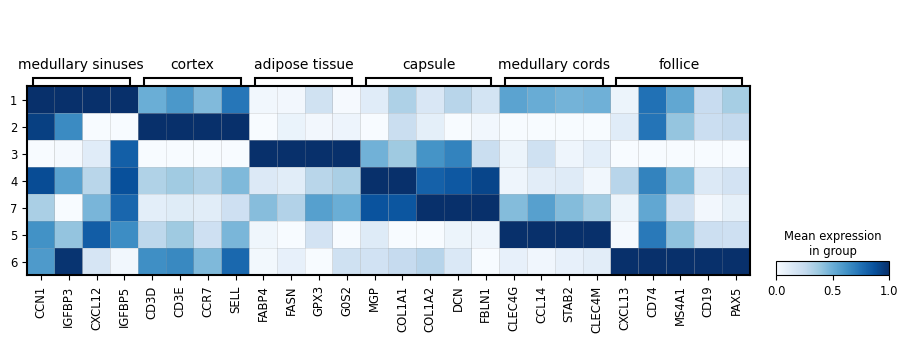

In [ ]:
rank_genes={'medullary sinuses': ['CCN1', 'IGFBP3', 'CXCL12', 'IGFBP5'],
            'cortex': ["CD3D", "CD3E", "CCR7", "SELL"],
            'adipose tissue': ['FABP4', 'FASN', 'GPX3', 'G0S2'],
            "capsule": [ 'MGP',"COL1A1", "COL1A2", "DCN", "FBLN1"],
            'medullary cords': ['CLEC4G', 'CCL14', 'STAB2', 'CLEC4M'],
            'follice': ['CXCL13', 'CD74','MS4A1',"CD19",  "PAX5"],
            }
sc.pl.matrixplot(adata_rna,var_names=rank_genes,groupby="SMART",standard_scale="var",categories_order=['1','2','3','4','7','5','6'],var_group_rotation=0,cmap="Blues")

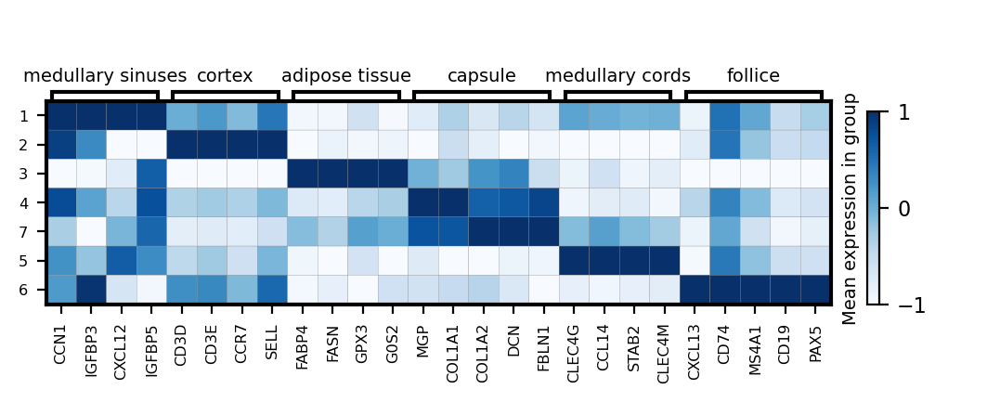

In [ ]:
plt.rcdefaults
plt.rcParams.update({
    'font.size': 7,            # default font size
})

fig, ax = plt.subplots(1, 1, figsize=(2*26/8, 2),dpi=200)
mp1=sc.pl.matrixplot(adata_rna, var_names=rank_genes, groupby='SMART',
                                  categories_order=['1','2','3','4','7','5','6'],
                                cmap='Blues',show=False,dendrogram=False,var_group_rotation=0,ax=ax,standard_scale='var')
mp1['color_legend_ax'].remove()
cmap = mpl.colormaps['Blues']
norm = mpl.colors.Normalize(vmin=-1, vmax=1)
cbar_ax = fig.add_axes([0.805, 0.11, 0.01, 0.52])  
cbar = fig.colorbar(
    mpl.cm.ScalarMappable(norm=norm, cmap=cmap),
    cax=cbar_ax, orientation='vertical',ticks=[-1,0,1]
)
cbar.ax.tick_params(labelsize=8)
# set label
cbar.set_label('Mean expression in group', rotation=90, size=7,labelpad=-33)
fig.savefig("rna_matrixplot.svg",format="svg",bbox_inches='tight',transparent=True)

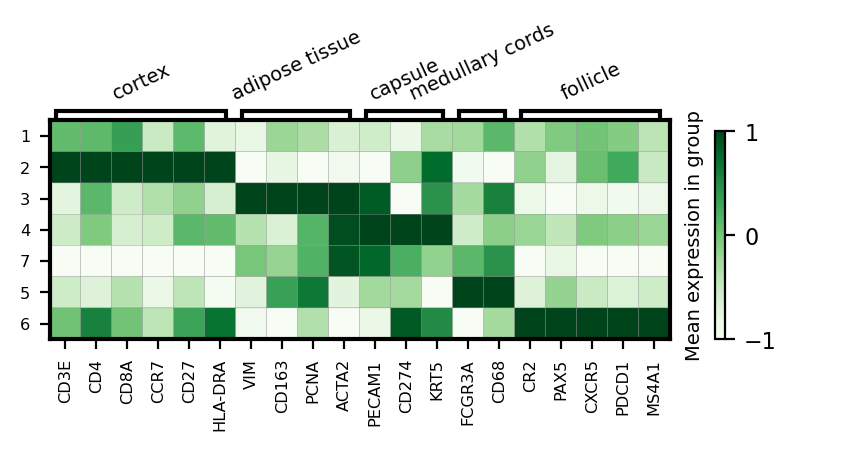

In [ ]:
plt.rcdefaults
plt.rcParams.update({
    'font.size': 7,            # 默认字体大小
})

fig, ax = plt.subplots(1, 1, figsize=(2*20/8, 2),dpi=200)
mp1=sc.pl.matrixplot(adata_adt, var_names=rank_adt, groupby='SMART',
                                  categories_order=['1','2','3','4','7','5','6'],
                                cmap='Greens',show=False,dendrogram=False,var_group_rotation=25,ax=ax,standard_scale='var')
mp1['color_legend_ax'].remove()
cmap = mpl.colormaps['Greens']
norm = mpl.colors.Normalize(vmin=-1, vmax=1)
cbar_ax = fig.add_axes([0.79, 0.11, 0.01, 0.52])  
cbar = fig.colorbar(
    mpl.cm.ScalarMappable(norm=norm, cmap=cmap),
    cax=cbar_ax, orientation='vertical',ticks=[-1,0,1]
)
cbar.ax.tick_params(labelsize=8)
# set label
cbar.set_label('Mean expression in group', rotation=90, size=7,labelpad=-33)
fig.savefig("adt_matrixplot.svg",format="svg",bbox_inches='tight',transparent=True)

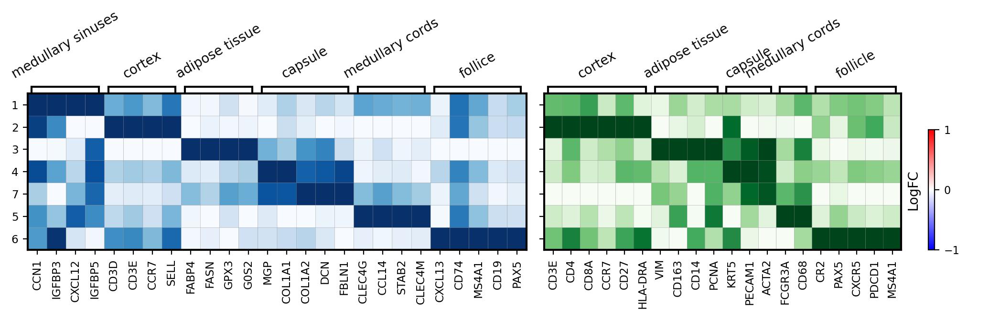

In [ ]:
fig, ax_list = plt.subplots(1, 2, figsize=(13, 3),dpi=200,width_ratios=[4,3])
plt.subplots_adjust(hspace=0, wspace=-0.15)

mp1=sc.pl.matrixplot(adata_rna, var_names=rank_genes, groupby='SMART',
                                  categories_order=['1','2','3','4','7','5','6'],
                                cmap='Blues',show=False,dendrogram=False,var_group_rotation=30,ax=ax_list[0],standard_scale='var')
mp1['color_legend_ax'].remove()
#mp1['mainplot_ax'].set_title("RNA (Replicate-1&2)",pad=30,size=12,fontweight='bold')

mp2=sc.pl.matrixplot(adata_adt, var_names=rank_adt, groupby='SMART',
                                   categories_order=['1','2','3','4','7','5','6'],
                                   cmap='Greens',show=False,ax=ax_list[1],
                                   dendrogram=False,var_group_rotation=30,standard_scale='var')
#mp2['mainplot_ax'].set_title("ADT (Replicate-1&2)",pad=30,size=12,fontweight='bold')
#mp2['mainplot_ax'].set_xticklabels(["F4_80","CD163","CD68","CD29","CD3","CD4","CD8","CD19","IgD","CD45R","CD169"])
mp2['mainplot_ax'].set_yticklabels([])
mp2['color_legend_ax'].remove()

cmap = mpl.colormaps['bwr']
norm = mpl.colors.Normalize(vmin=-1, vmax=1)
cbar_ax = fig.add_axes([0.85, 0.11, 0.005, 0.42])  
cbar = fig.colorbar(
    mpl.cm.ScalarMappable(norm=norm, cmap=cmap),
    cax=cbar_ax, orientation='vertical',ticks=[-1,0,1]
)
cbar.ax.tick_params(labelsize=8)
# set label
cbar.set_label('Mean', rotation=90, size=10,labelpad=-40)